In [1]:
#Importing all the necessory libraries and the data

In [2]:
import pandas as pd
import plotly.express as px
from copy import copy
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow import keras  
from tensorflow.keras import regularizers
import plotly.offline as py
import plotly.express as px
import plotly.graph_objects as go

In [3]:
from jupyterthemes import jtplot
jtplot.style(theme = 'monokai', context = 'notebook', ticks = True, grid = False) 

In [4]:
temperature_df = pd.read_csv('GlobalLandTemperaturesByCountry.csv')

In [5]:
temperature_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland
...,...,...,...,...
577457,2013-05-01,19.059,1.022,Zimbabwe
577458,2013-06-01,17.613,0.473,Zimbabwe
577459,2013-07-01,17.000,0.453,Zimbabwe
577460,2013-08-01,19.759,0.717,Zimbabwe


In [6]:
# Exploratory Data Analysis Cleaning Data

In [7]:
temperature_df['Country'].unique()

array(['Åland', 'Afghanistan', 'Africa', 'Albania', 'Algeria',
       'American Samoa', 'Andorra', 'Angola', 'Anguilla', 'Antarctica',
       'Antigua And Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Asia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Baker Island', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium',
       'Belize', 'Benin', 'Bhutan', 'Bolivia',
       'Bonaire, Saint Eustatius And Saba', 'Bosnia And Herzegovina',
       'Botswana', 'Brazil', 'British Virgin Islands', 'Bulgaria',
       'Burkina Faso', 'Burma', 'Burundi', "Côte D'Ivoire", 'Cambodia',
       'Cameroon', 'Canada', 'Cape Verde', 'Cayman Islands',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Colombia', 'Comoros',
       'Congo (Democratic Republic Of The)', 'Congo', 'Costa Rica',
       'Croatia', 'Cuba', 'Curaçao', 'Cyprus', 'Czech Republic',
       'Denmark (Europe)', 'Denmark', 'Djibouti', 'Dominica',
       'Dominican Republic', 'Ecu

In [8]:
temperature_df.isnull().sum()

dt                                   0
AverageTemperature               32651
AverageTemperatureUncertainty    31912
Country                              0
dtype: int64

In [9]:
temperature_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 577462 entries, 0 to 577461
Data columns (total 4 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   dt                             577462 non-null  object 
 1   AverageTemperature             544811 non-null  float64
 2   AverageTemperatureUncertainty  545550 non-null  float64
 3   Country                        577462 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.6+ MB


In [10]:
country_group_df = temperature_df.groupby(by = 'Country').count().reset_index('Country').rename(columns={'AverageTemperature':'AverageTemperatureCount','AverageTemperatureUncertainty' : 'AverageTemperatureUncertaintyCount'})

In [11]:
country_group_df

,Country,dt,AverageTemperatureCount,AverageTemperatureUncertaintyCount
0,Afghanistan,2106,2085,2085
1,Africa,1965,1894,1894
2,Albania,3239,3166,3166
3,Algeria,2721,2702,2702
4,American Samoa,1761,1629,1629
...,...,...,...,...
238,Western Sahara,2721,2536,2536
239,Yemen,1653,1649,1649
240,Zambia,1965,1690,1690
241,Zimbabwe,1965,1725,1725


In [12]:
country_group_df['Country']

0         Afghanistan
1              Africa
2             Albania
3             Algeria
4      American Samoa
            ...      
238    Western Sahara
239             Yemen
240            Zambia
241          Zimbabwe
242             Åland
Name: Country, Length: 243, dtype: object

In [13]:
import plotly.express as px
fig = px.bar(country_group_df, x = 'Country', y = 'AverageTemperatureCount')
fig.show()

In [14]:
fig = px.bar(country_group_df, x = 'Country', y = 'AverageTemperatureUncertaintyCount')
fig.show()

In [15]:
fig = px.histogram(country_group_df, x = "AverageTemperatureCount")
fig.show()

In [16]:
fig = px.histogram(country_group_df, x = "AverageTemperatureUncertaintyCount")
fig.show()

In [17]:
country_group_df[(country_group_df['AverageTemperatureCount'] < 1500) | (country_group_df['AverageTemperatureUncertaintyCount'] < 1500)]

,Country,dt,AverageTemperatureCount,AverageTemperatureUncertaintyCount
8,Antarctica,764,0,739
73,Federated States Of Micronesia,1427,1364,1364
80,French Southern And Antarctic Lands,788,783,783
91,Guam,1329,1328,1328
98,Heard Island And Mcdonald Islands,788,783,783
161,Northern Mariana Islands,1329,1328,1328
204,South Georgia And The South Sandwich Isla,1666,1474,1474


In [18]:
countries_with_less_data = country_group_df[(country_group_df['AverageTemperatureCount'] < 1500) | (country_group_df['AverageTemperatureUncertaintyCount'] < 1500)]

In [19]:
countries_with_less_data

,Country,dt,AverageTemperatureCount,AverageTemperatureUncertaintyCount
8,Antarctica,764,0,739
73,Federated States Of Micronesia,1427,1364,1364
80,French Southern And Antarctic Lands,788,783,783
91,Guam,1329,1328,1328
98,Heard Island And Mcdonald Islands,788,783,783
161,Northern Mariana Islands,1329,1328,1328
204,South Georgia And The South Sandwich Isla,1666,1474,1474


In [20]:
contoremove=countries_with_less_data.Country.tolist()
contoremove

['Antarctica',
 'Federated States Of Micronesia',
 'French Southern And Antarctic Lands',
 'Guam',
 'Heard Island And Mcdonald Islands',
 'Northern Mariana Islands',
 'South Georgia And The South Sandwich Isla']

In [21]:
for con in contoremove:
  temperature_df.drop(temperature_df.loc[temperature_df['Country']==con].index, inplace=True)

In [22]:
temperature_df.reset_index(inplace = True, drop = True)

In [23]:
temperature_df['AverageTemperature'] = temperature_df['AverageTemperature'].fillna(temperature_df['AverageTemperature'].rolling(730, min_periods = 1).mean())

In [24]:
temperature_df['AverageTemperatureUncertainty']= temperature_df['AverageTemperatureUncertainty'].fillna(temperature_df['AverageTemperatureUncertainty'].rolling(730, min_periods=1).mean())

In [25]:
temperature_df.isna().sum()

dt                               0
AverageTemperature               0
AverageTemperatureUncertainty    0
Country                          0
dtype: int64

In [26]:
temperature_df['Country'].unique()

array(['Åland', 'Afghanistan', 'Africa', 'Albania', 'Algeria',
       'American Samoa', 'Andorra', 'Angola', 'Anguilla',
       'Antigua And Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Asia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Baker Island', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium',
       'Belize', 'Benin', 'Bhutan', 'Bolivia',
       'Bonaire, Saint Eustatius And Saba', 'Bosnia And Herzegovina',
       'Botswana', 'Brazil', 'British Virgin Islands', 'Bulgaria',
       'Burkina Faso', 'Burma', 'Burundi', "Côte D'Ivoire", 'Cambodia',
       'Cameroon', 'Canada', 'Cape Verde', 'Cayman Islands',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Colombia', 'Comoros',
       'Congo (Democratic Republic Of The)', 'Congo', 'Costa Rica',
       'Croatia', 'Cuba', 'Curaçao', 'Cyprus', 'Czech Republic',
       'Denmark (Europe)', 'Denmark', 'Djibouti', 'Dominica',
       'Dominican Republic', 'Ecuador', 'Egypt'

In [27]:
duplicates = []
for i in temperature_df['Country'].unique():
    if '(' in i:
        duplicates.append(i)
duplicates

['Congo (Democratic Republic Of The)',
 'Denmark (Europe)',
 'Falkland Islands (Islas Malvinas)',
 'France (Europe)',
 'Netherlands (Europe)',
 'United Kingdom (Europe)']

In [28]:
temperature_df = temperature_df.replace(duplicates, ['Congo', 'Denmark','Falkland Islands','France','Netherlands','United Kingdom'])

In [29]:
temperature_df['Country'].unique()

array(['Åland', 'Afghanistan', 'Africa', 'Albania', 'Algeria',
       'American Samoa', 'Andorra', 'Angola', 'Anguilla',
       'Antigua And Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Asia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Baker Island', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium',
       'Belize', 'Benin', 'Bhutan', 'Bolivia',
       'Bonaire, Saint Eustatius And Saba', 'Bosnia And Herzegovina',
       'Botswana', 'Brazil', 'British Virgin Islands', 'Bulgaria',
       'Burkina Faso', 'Burma', 'Burundi', "Côte D'Ivoire", 'Cambodia',
       'Cameroon', 'Canada', 'Cape Verde', 'Cayman Islands',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Colombia', 'Comoros', 'Congo', 'Costa Rica',
       'Croatia', 'Cuba', 'Curaçao', 'Cyprus', 'Czech Republic',
       'Denmark', 'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador',
       'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
     

In [30]:
# Data Visualisation

In [31]:
countries = temperature_df['Country'].unique().tolist()
countries

['Åland',
 'Afghanistan',
 'Africa',
 'Albania',
 'Algeria',
 'American Samoa',
 'Andorra',
 'Angola',
 'Anguilla',
 'Antigua And Barbuda',
 'Argentina',
 'Armenia',
 'Aruba',
 'Asia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Baker Island',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia',
 'Bonaire, Saint Eustatius And Saba',
 'Bosnia And Herzegovina',
 'Botswana',
 'Brazil',
 'British Virgin Islands',
 'Bulgaria',
 'Burkina Faso',
 'Burma',
 'Burundi',
 "Côte D'Ivoire",
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Cayman Islands',
 'Central African Republic',
 'Chad',
 'Chile',
 'China',
 'Christmas Island',
 'Colombia',
 'Comoros',
 'Congo',
 'Costa Rica',
 'Croatia',
 'Cuba',
 'Curaçao',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Equatorial Guinea',
 'Eritrea',
 'Estonia',
 'Ethiopia',
 'Europe',
 'Falkland Islands'

In [32]:
mean_temperature = []
for i in countries:
    mean_temperature.append(temperature_df[temperature_df['Country'] == i]['AverageTemperature'].mean())

In [33]:
data = [ dict(type = 'choropleth', # type of map
              locations = countries, # location names
              z = mean_temperature, # temperature of countries
              locationmode = 'country names')
       ]

layout = dict(title = 'Average Global Land Temperatures',
              geo = dict(showframe = False,
                         showocean = True, # to show the ocean
                         oceancolor = 'aqua',
                         projection = dict(type = 'orthographic'))) # to get the globe view),

fig = dict(data = data, layout = layout)
py.iplot(fig, validate = False, filename = 'worldmap')

In [34]:
temperature_df['year'] = temperature_df['dt'].apply(lambda x: x.split('-')[0])
temperature_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,year
0,1743-11-01,4.384000,2.294000,Åland,1743
1,1743-12-01,4.384000,2.294000,Åland,1743
2,1744-01-01,4.384000,2.294000,Åland,1744
3,1744-02-01,4.384000,2.294000,Åland,1744
4,1744-03-01,4.384000,2.294000,Åland,1744
...,...,...,...,...,...
569366,2013-05-01,19.059000,1.022000,Zimbabwe,2013
569367,2013-06-01,17.613000,0.473000,Zimbabwe,2013
569368,2013-07-01,17.000000,0.453000,Zimbabwe,2013
569369,2013-08-01,19.759000,0.717000,Zimbabwe,2013


In [35]:
fig = px.choropleth(temperature_df, locations = 'Country',
                    locationmode = 'country names', # locations 
                    color = 'AverageTemperature', # column representing the temperature
                    hover_name = "Country", # column to add to hover information
                    animation_frame = 'year', # timeframe for animation
                    color_continuous_scale = px.colors.sequential.deep_r)
# py.plot(fig)
fig.show()

In [36]:
numeric_cols = temperature_df.select_dtypes(include=[np.number]).columns.tolist()
df_global = temperature_df.groupby('year')[numeric_cols].mean().reset_index()


In [37]:
df_global

,year,AverageTemperature,AverageTemperatureUncertainty
0,1743,11.371022,1.271705
1,1744,12.416144,1.545112
2,1745,12.034958,0.906291
3,1746,17.367274,0.379388
4,1747,17.375121,0.379358
...,...,...,...
266,2009,19.651797,0.338063
267,2010,19.732416,0.335082
268,2011,19.558313,0.352710
269,2012,19.569815,0.451734


In [38]:
df_global['year'] = df_global['year'].apply(lambda x: int(x))
df_global = df_global[df_global['year'] > 1850]

In [39]:
trace1 = go.Scatter(
    x = df_global['year'], 
    y = np.array(df_global['AverageTemperature']) + np.array(df_global['AverageTemperatureUncertainty']), # Adding uncertinity
    name = 'Uncertainty top',
    line = dict(color = 'green'))

# Uncertainity lower bound
trace2 = go.Scatter(
    x = df_global['year'] , 
    y = np.array(df_global['AverageTemperature']) - np.array(df_global['AverageTemperatureUncertainty']), # Subtracting uncertinity
    fill = 'tonexty',
    name = 'Uncertainty bottom',
    line = dict(color = 'green'))

# Recorded temperature
trace3 = go.Scatter(
    x = df_global['year'] , 
    y = df_global['AverageTemperature'],
    name = 'Average Temperature',
    line = dict(color='red'))
data = [trace1, trace2, trace3]

layout = go.Layout(
    xaxis = dict(title = 'year'),
    yaxis = dict(title = 'Average Temperature, °C'),
    title = 'Average Land Temperatures Globally',
    showlegend = False)

fig = go.Figure(data = data, layout = layout)
py.iplot(fig)

In [40]:
Pl_df = temperature_df[temperature_df['Country'] == 'Poland'].reset_index(drop = True)
Pl_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,year
0,1743-11-01,3.937000,2.057000,Poland,1743
1,1743-12-01,26.854102,0.229139,Poland,1743
2,1744-01-01,26.855497,0.229276,Poland,1744
3,1744-02-01,26.855413,0.229412,Poland,1744
4,1744-03-01,26.854229,0.229383,Poland,1744
...,...,...,...,...,...
3234,2013-05-01,14.957000,0.232000,Poland,2013
3235,2013-06-01,17.811000,0.209000,Poland,2013
3236,2013-07-01,19.584000,0.417000,Poland,2013
3237,2013-08-01,19.148000,0.340000,Poland,2013


In [41]:
fig = px.line(title = 'Poland Temperature Data')
Pl_df_updated = Pl_df[Pl_df['year'] > '1743']
fig.add_scatter(x = Pl_df_updated['dt'], y = Pl_df_updated['AverageTemperature'], name = 'PL Temperature')
fig.show()

In [42]:
# Preparing Poland Dataframe to train the model

In [43]:
Pl_df = temperature_df[temperature_df['Country'] == 'Poland'].reset_index(drop = True)
Pl_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,year
0,1743-11-01,3.937000,2.057000,Poland,1743
1,1743-12-01,26.854102,0.229139,Poland,1743
2,1744-01-01,26.855497,0.229276,Poland,1744
3,1744-02-01,26.855413,0.229412,Poland,1744
4,1744-03-01,26.854229,0.229383,Poland,1744
...,...,...,...,...,...
3234,2013-05-01,14.957000,0.232000,Poland,2013
3235,2013-06-01,17.811000,0.209000,Poland,2013
3236,2013-07-01,19.584000,0.417000,Poland,2013
3237,2013-08-01,19.148000,0.340000,Poland,2013


In [44]:
Pl_df = Pl_df.drop(['Country', 'year'], axis = 1)

In [45]:
def prepare_data(df, feature_range):
    # Get the columns
    columns = df.columns
    # For the given range, create lagged input feature for the given columns
    for i in range(1, (feature_range + 1)):
        for j in columns[1:]:
            name = j + '_t-' + str(i)
            df[name] = df[j].shift((i))
    # Create the target by using next value as the target
    df['Target'] = df['AverageTemperature'].shift(-1)
    return df

In [46]:
Pl_df = prepare_data(Pl_df, 3)

In [47]:
Pl_df

,dt,AverageTemperature,AverageTemperatureUncertainty,AverageTemperature_t-1,AverageTemperatureUncertainty_t-1,AverageTemperature_t-2,AverageTemperatureUncertainty_t-2,AverageTemperature_t-3,AverageTemperatureUncertainty_t-3,Target
0,1743-11-01,3.937000,2.057000,NaN,NaN,NaN,NaN,NaN,NaN,26.854102
1,1743-12-01,26.854102,0.229139,3.937000,2.057000,NaN,NaN,NaN,NaN,26.855497
2,1744-01-01,26.855497,0.229276,26.854102,0.229139,3.937000,2.057000,NaN,NaN,26.855413
3,1744-02-01,26.855413,0.229412,26.855497,0.229276,26.854102,0.229139,3.937000,2.057000,26.854229
4,1744-03-01,26.854229,0.229383,26.855413,0.229412,26.855497,0.229276,26.854102,0.229139,8.889000
...,...,...,...,...,...,...,...,...,...,...
3234,2013-05-01,14.957000,0.232000,8.173000,0.279000,-1.391000,0.269000,-0.813000,0.388000,17.811000
3235,2013-06-01,17.811000,0.209000,14.957000,0.232000,8.173000,0.279000,-1.391000,0.269000,19.584000
3236,2013-07-01,19.584000,0.417000,17.811000,0.209000,14.957000,0.232000,8.173000,0.279000,19.148000
3237,2013-08-01,19.148000,0.340000,19.584000,0.417000,17.811000,0.209000,14.957000,0.232000,8.004112


In [48]:
Pl_df = Pl_df.dropna().reset_index(drop = True)

In [49]:
train = Pl_df[:int(0.9 * len(Pl_df))].drop(columns = 'dt').values

In [50]:
test = Pl_df[int(0.9 * len(Pl_df)):].drop(columns = 'dt').values

In [51]:
scaler = MinMaxScaler(feature_range = (0, 1))
train  = scaler.fit_transform(train)
test   = scaler.transform(test)


In [52]:
train_x, train_y = train[:,:-1], train[:,-1]
test_x, test_y = test[:,:-1], test[:,-1]

In [53]:
print("Original train_x shape:", train_x.shape)
print("Original test_x shape:", test_x.shape)


Original train_x shape: (2911, 8)
Original test_x shape: (324, 8)


In [54]:
train_x = train_x.reshape((train_x.shape[0], 1, train_x.shape[1]))
test_x = test_x.reshape((test_x.shape[0], 1, test_x.shape[1]))
print(train_x.shape, train_y.shape, test_x.shape, test_y.shape)

(2911, 1, 8) (2911,) (324, 1, 8) (324,)


In [55]:
train_x

array([[[1.        , 0.01167465, 1.        , ..., 0.01165288,
         0.42649988, 0.15740372]],

       [[0.99997037, 0.01167239, 0.99999791, ..., 0.01166386,
         0.99996509, 0.01165288]],

       [[0.55041721, 0.24136831, 0.99996828, ..., 0.01167465,
         1.        , 0.01166386]],

       ...,

       [[0.74257277, 0.01387449, 0.70005636, ..., 0.00956861,
         0.3611386 , 0.04409537]],

       [[0.78271049, 0.01044574, 0.74257122, ..., 0.00669803,
         0.53973104, 0.00956861]],

       [[0.77047399, 0.00789411, 0.78270886, ..., 0.01387449,
         0.70005636, 0.00669803]]])

In [56]:
# Building and Training Model for temperature prediction with Poland Data

In [57]:
def create_model(train_x):
    # Create the model
    inputs = keras.layers.Input(shape = (train_x.shape[1], train_x.shape[2]))
    x = keras.layers.LSTM(50,return_sequences =  True,kernel_regularizer=regularizers.l2(0.001))(inputs)
    x = keras.layers.Dropout(0.2)(x)
    x = keras.layers.LSTM(50, return_sequences = True, kernel_regularizer=regularizers.l2(0.001))(x)
    x = keras.layers.Dropout(0.2)(x)
    x = keras.layers.LSTM(50)(x)
    outputs = keras.layers.Dense(1, activation = 'linear')(x)

    model = keras.Model(inputs = inputs, outputs = outputs)
    model.compile(optimizer = 'adam', loss = "mse")
    return model

In [58]:
model = create_model(train_x)
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 1, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 1, 50)          │        11,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1, 50)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 1, 50)          │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1, 50)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 50)             │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            51 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,251 (204.11 KB)

 Trainable params: 52,251 (204.11 KB)

 Non-trainable params: 0 (0.00 B)

In [59]:
history = model.fit(train_x, train_y, epochs = 50, batch_size = 36, validation_data = (test_x, test_y), shuffle = False)


Epoch 1/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.3362 - val_loss: 0.0607
Epoch 2/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0708 - val_loss: 0.0366
Epoch 3/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.0465 - val_loss: 0.0222
Epoch 4/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0338 - val_loss: 0.0166
Epoch 5/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0311 - val_loss: 0.0141
Epoch 6/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0292 - val_loss: 0.0127
Epoch 7/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0295 - val_loss: 0.0117
Epoch 8/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0296 - val_loss: 0.0110
Epoch 9/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0284 - val_loss: 0.0105
Epoch 10/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0290 - val_loss: 0.0103
Epoch 11/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0280 - val_loss: 0.0098
Epoch 12/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0277 - val_

In [60]:
def plot_history(history):
    # plot history
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.grid()
    plt.legend()
    plt.show()

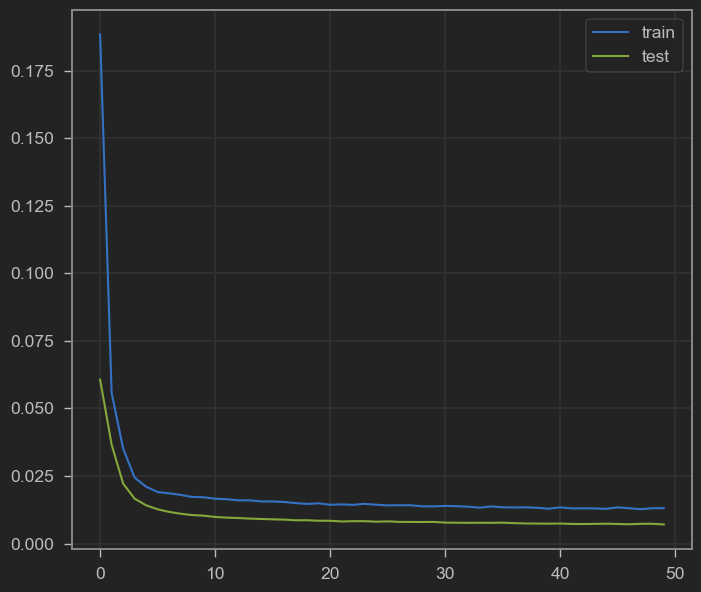

In [61]:
plot_history(history)

In [62]:
# Assessing Model Performance (Poland Data)

In [63]:
def prediction(model,test_x,train_x, df):
    # Predict using the model
    predict =  model.predict(test_x)

    # Reshape test_x and train_x for visualization  and inverse-scaling purpose
    test_x = test_x.reshape((test_x.shape[0], test_x.shape[2]))
    train_x = train_x.reshape((train_x.shape[0], train_x.shape[2]))

    # Concatenate test_x with predicted value
    predict_ = np.concatenate((test_x, predict),axis = 1)

    # Inverse-scaling to get the real values
    predict_ = scaler.inverse_transform(predict_)
    original_ = scaler.inverse_transform(test)

    # Create dataframe to store the predicted and original values
    pred = pd.DataFrame()
    pred['dt'] = df['dt'][-test_x.shape[0]:]
    pred['Original'] = original_[:,-1]
    pred['Predicted'] = predict_[:,-1]

    # Calculate the error 
    pred['Error'] = pred['Original'] - pred['Predicted']

    # Calculate performance metrics
    mse = mean_squared_error(pred['Original'], pred['Predicted'])
    mae = mean_absolute_error(pred['Original'], pred['Predicted'])
    r2 = r2_score(pred['Original'], pred['Predicted'])

    print(f'MSE: {mse}, MAE: {mae}, R-squared: {r2}')
    
    # Create dataframe for visualization
    df = df[['dt','AverageTemperature']][:-test_x.shape[0]]
    df.columns = ['dt','Original']
    original = pd.concat([df, pred[['dt', 'Original']]], ignore_index=True)
    df.columns = ['dt', 'Predicted']
    predicted = pd.concat([df, pred[['dt', 'Predicted']]], ignore_index=True)
    original = original.merge(predicted, left_on = 'dt',right_on = 'dt')
    return pred, original

In [64]:
pred, original = prediction(model, test_x, train_x, Pl_df )

11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
MSE: 6.385614464930947, MAE: 2.025588216812601, R-squared: 0.895394803516722


In [65]:
def plot(df):
    # Plotting the Current and Predicted values
    fig = px.line(title = 'Prediction vs. Actual')
    fig.add_scatter(x = df['dt'], y = df['Original'], name = 'Original', opacity = 0.7)
    fig.add_scatter(x = df['dt'], y = df['Predicted'], name = 'Predicted', opacity = 0.5)
    fig.show()


In [66]:
def plot_error(df):

    # Plotting the Current and Predicted values
    fig = px.line(title = 'Prediction vs. Actual')
    fig.add_scatter(x = df['dt'], y = df['Original'], name = 'Original', opacity = 0.7)
    fig.add_scatter(x = df['dt'], y = df['Predicted'], name = 'Predicted', opacity = 0.5)
    fig.show()

    fig = px.line(title = 'Error')
    fig = fig.add_scatter(x = df['dt'], y = df['Error'])
    fig.show()


In [67]:
plot(original)

In [68]:
plot_error(pred)

In [69]:
# Preparing Data to Train Global LSTM Model

In [70]:
temperature_df['Month'] = temperature_df['dt'].apply(lambda x: int(x.split('-')[1]))

In [71]:
print(temperature_df.dtypes)


dt                                object
AverageTemperature               float64
AverageTemperatureUncertainty    float64
Country                           object
year                              object
Month                              int64
dtype: object


In [72]:
numeric_cols = temperature_df.select_dtypes(include=[np.number]).columns.tolist()
df_global_monthly = temperature_df.groupby('dt')[numeric_cols].mean().reset_index()


In [73]:
df_global_monthly

,dt,AverageTemperature,AverageTemperatureUncertainty,Month
0,1743-11-01,5.184140,2.183520,11.0
1,1743-12-01,17.557905,0.359890,12.0
2,1744-01-01,17.565159,0.359919,1.0
3,1744-02-01,17.568875,0.359907,2.0
4,1744-03-01,17.569168,0.359897,3.0
...,...,...,...,...
3234,2013-05-01,21.628038,0.471356,5.0
3235,2013-06-01,22.938568,0.510081,6.0
3236,2013-07-01,23.695627,0.508631,7.0
3237,2013-08-01,23.525953,0.587106,8.0


In [74]:
df_global_monthly = prepare_data(df_global_monthly, 3)

In [75]:
df_global_monthly

,dt,AverageTemperature,AverageTemperatureUncertainty,Month,AverageTemperature_t-1,AverageTemperatureUncertainty_t-1,Month_t-1,AverageTemperature_t-2,AverageTemperatureUncertainty_t-2,Month_t-2,AverageTemperature_t-3,AverageTemperatureUncertainty_t-3,Month_t-3,Target
0,1743-11-01,5.184140,2.183520,11.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.557905
1,1743-12-01,17.557905,0.359890,12.0,5.184140,2.183520,11.0,NaN,NaN,NaN,NaN,NaN,NaN,17.565159
2,1744-01-01,17.565159,0.359919,1.0,17.557905,0.359890,12.0,5.184140,2.183520,11.0,NaN,NaN,NaN,17.568875
3,1744-02-01,17.568875,0.359907,2.0,17.565159,0.359919,1.0,17.557905,0.359890,12.0,5.184140,2.183520,11.0,17.569168
4,1744-03-01,17.569168,0.359897,3.0,17.568875,0.359907,2.0,17.565159,0.359919,1.0,17.557905,0.359890,12.0,8.661480
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3234,2013-05-01,21.628038,0.471356,5.0,19.464860,0.551025,4.0,17.252064,0.576445,3.0,15.885475,0.561750,2.0,22.938568
3235,2013-06-01,22.938568,0.510081,6.0,21.628038,0.471356,5.0,19.464860,0.551025,4.0,17.252064,0.576445,3.0,23.695627
3236,2013-07-01,23.695627,0.508631,7.0,22.938568,0.510081,6.0,21.628038,0.471356,5.0,19.464860,0.551025,4.0,23.525953
3237,2013-08-01,23.525953,0.587106,8.0,23.695627,0.508631,7.0,22.938568,0.510081,6.0,21.628038,0.471356,5.0,19.426306


In [76]:
df_global_monthly = df_global_monthly.dropna().reset_index(drop = True)

In [77]:
df_global_monthly

,dt,AverageTemperature,AverageTemperatureUncertainty,Month,AverageTemperature_t-1,AverageTemperatureUncertainty_t-1,Month_t-1,AverageTemperature_t-2,AverageTemperatureUncertainty_t-2,Month_t-2,AverageTemperature_t-3,AverageTemperatureUncertainty_t-3,Month_t-3,Target
0,1744-02-01,17.568875,0.359907,2.0,17.565159,0.359919,1.0,17.557905,0.359890,12.0,5.184140,2.183520,11.0,17.569168
1,1744-03-01,17.569168,0.359897,3.0,17.568875,0.359907,2.0,17.565159,0.359919,1.0,17.557905,0.359890,12.0,8.661480
2,1744-04-01,8.661480,2.801440,4.0,17.569168,0.359897,3.0,17.568875,0.359907,2.0,17.565159,0.359919,1.0,11.098360
3,1744-05-01,11.098360,1.994440,5.0,8.661480,2.801440,4.0,17.569168,0.359897,3.0,17.568875,0.359907,2.0,14.927720
4,1744-06-01,14.927720,2.020060,6.0,11.098360,1.994440,5.0,8.661480,2.801440,4.0,17.569168,0.359897,3.0,17.094300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3230,2013-04-01,19.464860,0.551025,4.0,17.252064,0.576445,3.0,15.885475,0.561750,2.0,15.005826,0.519525,1.0,21.628038
3231,2013-05-01,21.628038,0.471356,5.0,19.464860,0.551025,4.0,17.252064,0.576445,3.0,15.885475,0.561750,2.0,22.938568
3232,2013-06-01,22.938568,0.510081,6.0,21.628038,0.471356,5.0,19.464860,0.551025,4.0,17.252064,0.576445,3.0,23.695627
3233,2013-07-01,23.695627,0.508631,7.0,22.938568,0.510081,6.0,21.628038,0.471356,5.0,19.464860,0.551025,4.0,23.525953


In [78]:
train = df_global_monthly[:int(0.9 * len(df_global_monthly))].drop(columns = 'dt').values

In [79]:
test = df_global_monthly[int(0.9 * len(df_global_monthly)):].drop(columns = 'dt').values

In [80]:
scaler = MinMaxScaler(feature_range = (0, 1))
train  = scaler.fit_transform(train)
test   = scaler.transform(test)

In [81]:
train_x, train_y = train[:,:-1], train[:,-1]
test_x, test_y = test[:,:-1], test[:,-1]

In [82]:
train_x = train_x.reshape((train_x.shape[0], 1, train_x.shape[1]))
test_x = test_x.reshape((test_x.shape[0], 1, test_x.shape[1]))
print(train_x.shape, train_y.shape, test_x.shape, test_y.shape)

(2911, 1, 12) (2911,) (324, 1, 12) (324,)


In [83]:
# Building and Training Global LSTM Model

In [84]:
model = create_model(train_x)
model.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 1, 12)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_3 (LSTM)                   │ (None, 1, 50)          │        12,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 1, 50)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_4 (LSTM)                   │ (None, 1, 50)          │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 1, 50)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_5 (LSTM)                   │ (None, 50)             │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            51 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 53,051 (207.23 KB)

 Trainable params: 53,051 (207.23 KB)

 Non-trainable params: 0 (0.00 B)

In [85]:
history = model.fit(train_x, train_y, epochs = 50, batch_size = 36, validation_data = (test_x, test_y), shuffle = False)


Epoch 1/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - loss: 0.3246 - val_loss: 0.0618
Epoch 2/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1006 - val_loss: 0.0323
Epoch 3/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0687 - val_loss: 0.0205
Epoch 4/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0473 - val_loss: 0.0158
Epoch 5/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0379 - val_loss: 0.0125
Epoch 6/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0326 - val_loss: 0.0105
Epoch 7/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0304 - val_loss: 0.0088
Epoch 8/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0281 - val_loss: 0.0075
Epoch 9/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0262 - val_loss: 0.0072
Epoch 10/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0247 - val_loss: 0.0065
Epoch 11/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0241 - val_loss: 0.0063
Epoch 12/50
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0230 - v

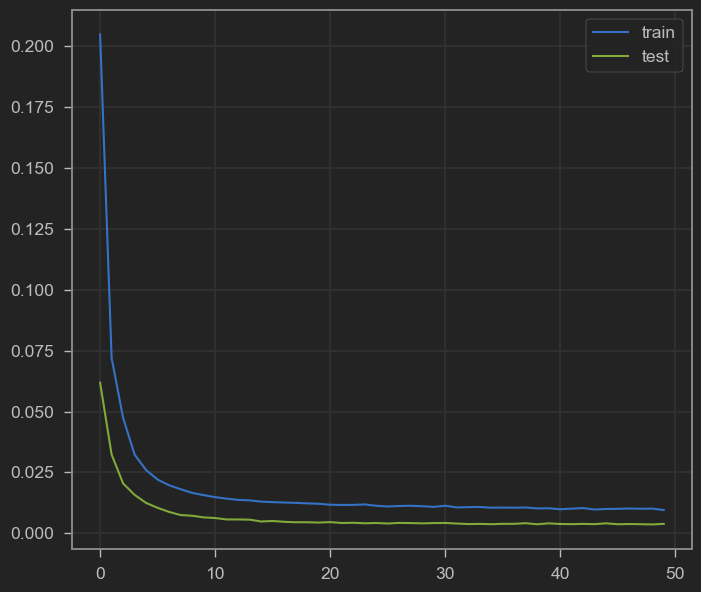

In [86]:
plot_history(history)

In [87]:
#ASSESS MODEL PERFORMANCE (GLOBAL DATA)

In [88]:
pred, original = prediction(model, test_x, train_x, df_global_monthly )

11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 70ms/step
MSE: 1.0808192465357167, MAE: 0.8553971114071901, R-squared: 0.889375438529573


In [89]:
plot(original)

In [90]:
plot_error(pred)